In [1]:
 #load Raw data from TDT ECoG maschine, plz run ""
import numpy as np
import os
import matplotlib.pyplot as plt
from scipy.fftpack import fft
import h5py
import scipy.io as scio
from torch.utils.data import TensorDataset, DataLoader
from torch.utils.data.dataset import random_split
import matplotlib
plt.rcParams['axes.unicode_minus'] = False
# matplotlib.rcParams['font.family'] = 'sans-serif'
matplotlib.rcParams['font.sans-serif'] = ['SimHei']
# matplotlib.rcParams['font.size'] = 10
import matplotlib as mpl
mpl.rcParams['text.usetex'] = False
from matplotlib.colors import Normalize
from matplotlib.patches import Rectangle
import scipy.io as scio
import matplotlib.image as mpimg
from scipy import stats

PATH='/public/DATA/overt_reading/points'
bands_list = ['theta', 'alpha', 'beta1', 'beta2', 'low gamma', 'high gamma']
freq_list=[400]
HS_list=[68, 69, 75, 79, 82, 83, 84, 85, 86]
mpl.rcParams['font.size'] =10

In [5]:
HS = 69
freq = 400
save_path = f'/public/DATA/overt_reading/aligned_data/HS{HS}'
cue_data = np.load(os.path.join(save_path, f'cue_allbands_{freq}hz.npy'), allow_pickle=True).item()
read_data = np.load(os.path.join(save_path, f'read_allbands_{freq}hz.npy'), allow_pickle=True).item()

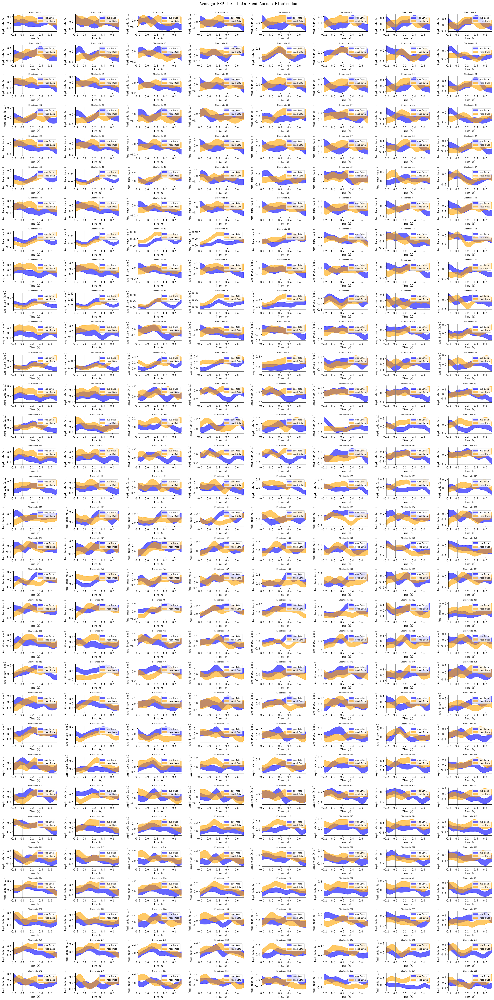

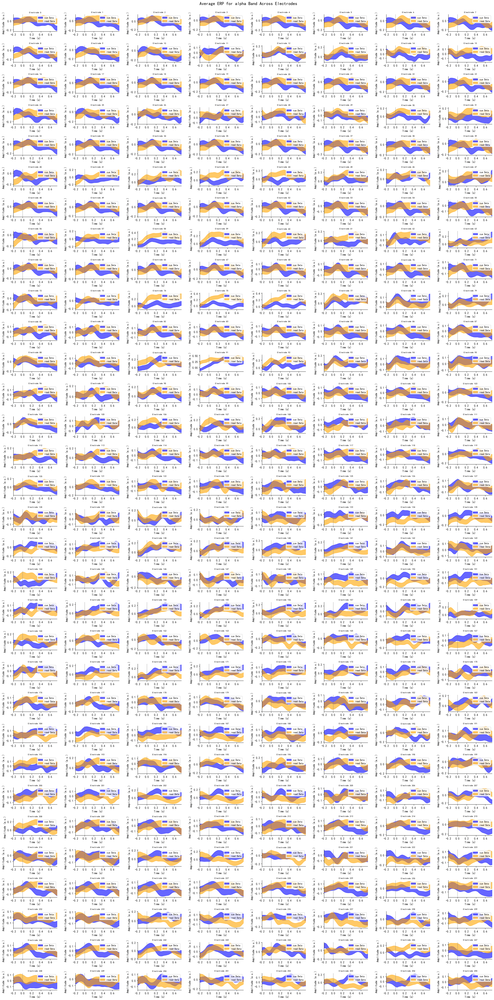

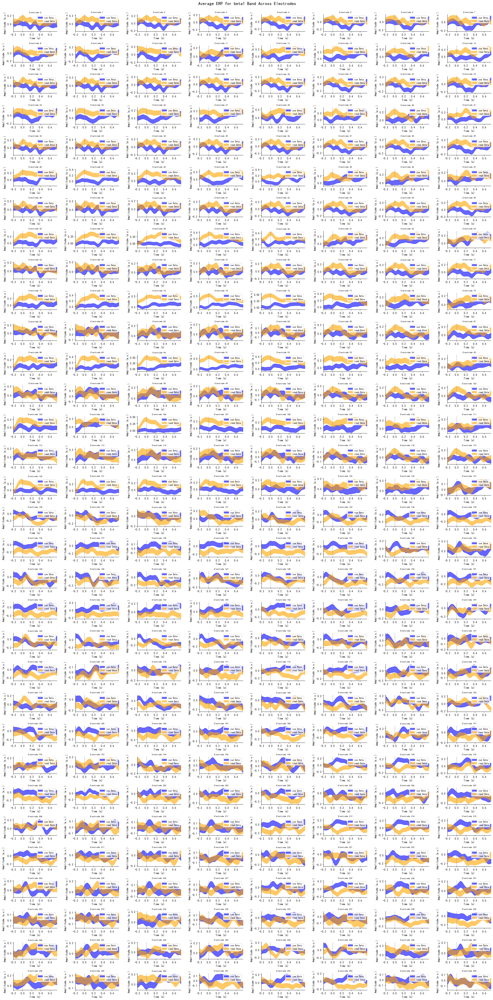

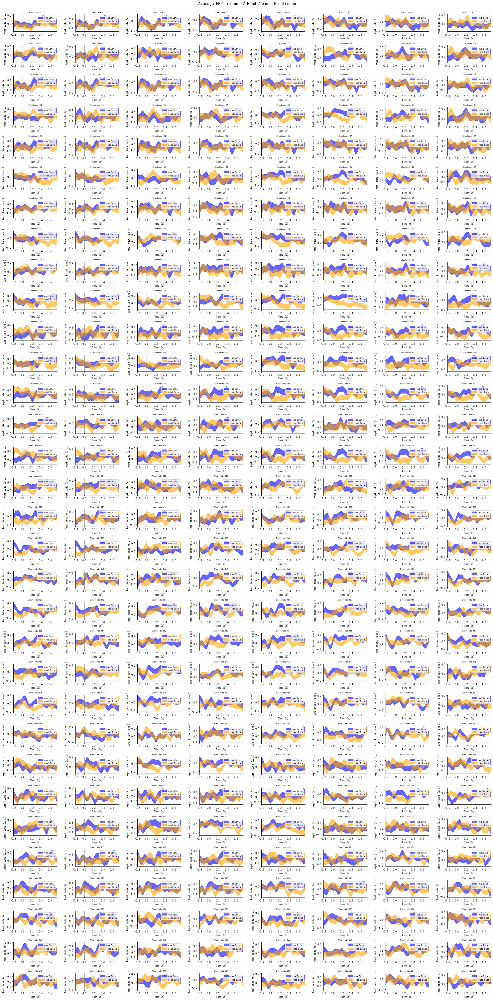

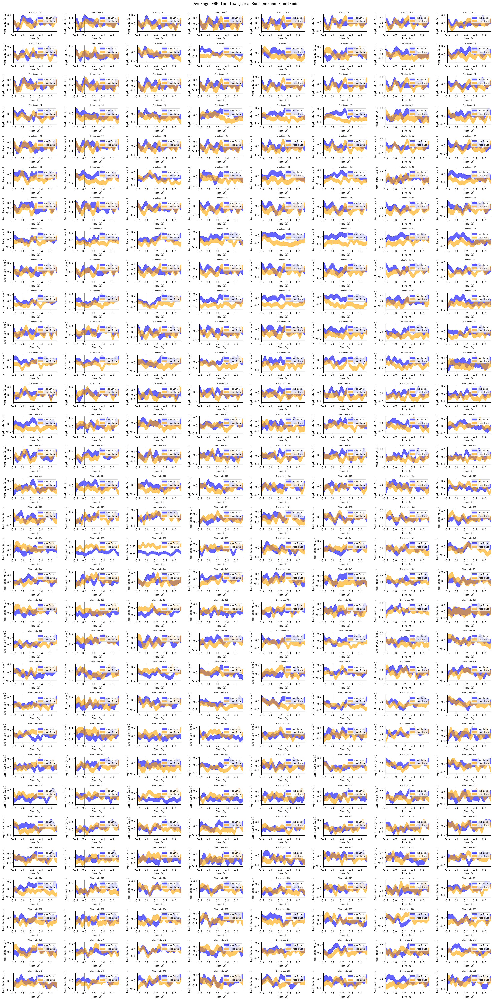

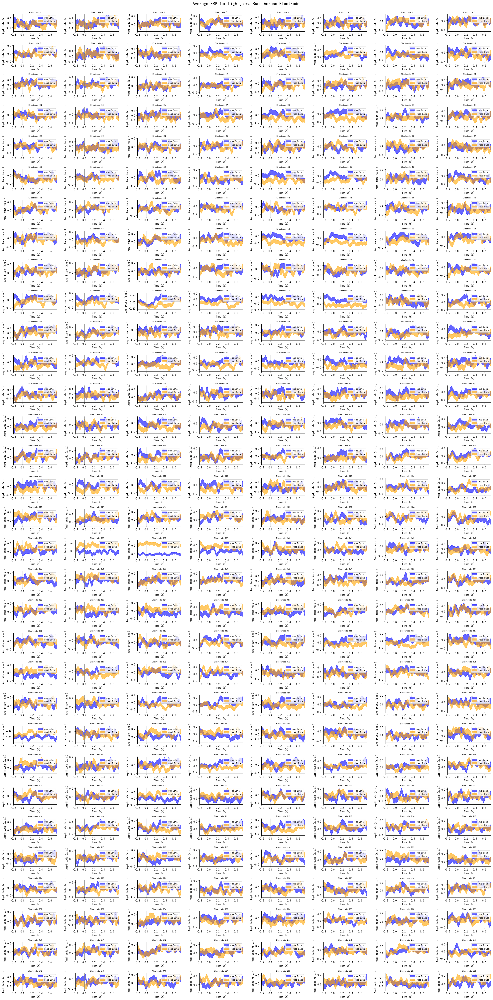

In [6]:
def nansem(a, axis=0):
    return np.nanstd(a, axis=axis) / np.sqrt(a.shape[axis])

def plot_filled_sem(a, xvals, ax=None, color=None, ylim=None, alpha=0.6, label=None):
    if ax is None:
        fig, ax = plt.subplots()
    # print(a.shape)
    # print(xvals.shape)
    mean = np.nanmean(a, axis=0)
    # print(mean.shape)
    
    sem = nansem(a, axis=0)
    # print(sem.shape)
    # print(mean.shape, sem.shape)
    ax.axvline(0, color='gray', linewidth=0.5)
    #ax.axhline(0, color='gray', linewidth=0.5)

    if color is not None:
        h = ax.fill_between(xvals, mean - sem, mean + sem, alpha=alpha, color=color, label=label)
    else:
        h = ax.fill_between(xvals, mean - sem, mean + sem, alpha=alpha, label=label)

    if ylim is not None:
        ax.set(ylim=ylim)
    ax.set(xlim=(xvals[0], xvals[-1]))
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    return h

import numpy as np
import matplotlib.pyplot as plt

def plt_avg_erp_by_electrodes(cue_data, read_data, band):
    n_electrodes = cue_data.shape[1]  # 获取电极数量
    # random_indices = np.random.choice(n_electrodes, size=n_electrodes // 2, replace=False)  # 随机选择一半电极
    # electrode_list = random_indices.tolist()  # 转换为列表
    electrode_list = [i for i in range(n_electrodes)]

    n_elec = len(electrode_list)
    # n_cols = 11  # 每行的子图数量
    # n_rows = (n_elec + n_cols - 1) // n_cols  # 计算行数

    # fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, 2.5 * n_rows))
    fig, axs = plt.subplots(int(n_elec/8), 8, figsize=(25, int(n_elec*25/128)))
    axs = axs.flatten()  # 将 axs 转换为一维数组，方便索引

    for i, electrode_index in enumerate(electrode_list):
        # 提取 ERP 数据
        cue_erp = cue_data[:, electrode_index, :]
        read_erp = read_data[:, electrode_index, :]
        
        # 创建时间轴
        xval = np.linspace(-0.2, 0.75, cue_data.shape[2])
        plot_filled_sem(cue_erp, xvals=xval, ax=axs[i], color='blue', label='cue Data')
        plot_filled_sem(read_erp, xvals=xval, ax=axs[i], color='orange', label='read Data')

        # 设置子图的标题和标签
        axs[i].set_title(f'Electrode {electrode_index}', fontsize=8)
        # axs[i].legend()
        axs[i].legend(loc='upper right', fontsize='small', frameon=True)

        axs[i].set_xlabel('Time (s)')
        axs[i].set_ylabel('Amplitude (a.u.)')


    plt.subplots_adjust(hspace=0.5)
    fig.suptitle(f'Average ERP for {band} Band Across Electrodes', fontsize=16, y=1)
    plt.tight_layout()
    plt.show()

for band in bands_list:
    cue_band_data = cue_data[band]
    read_band_data = read_data[band]
    plt_avg_erp_by_electrodes(cue_band_data, read_band_data, band)

# plt_avg_erp_by_electrodes(elec_idx, z_cue_data, z_read_data)